In [1]:
# imports
from openeo import connect, Connection
from openeo.rest.datacube import DataCube
from typing import List, Dict, Tuple, Union
from pathlib import Path
import xarray as xr
import hvplot.xarray

%matplotlib inline

In [2]:
# Connect to VITO backend
vito_url: str = "https://openeo.vito.be/openeo/1.0"
vito_creo_url: str = "https://openeo.creo.vito.be"
vito_dev_url: str = "https://openeo-dev.vito.be/openeo/1.0/"
ee_url: str = "https://earthengine.openeo.org"
openeo_platform: str = "openeo.cloud"

# con: Connection = connect(ee_url).authenticate_basic(username="group1", password="test123")
con: Connection = connect(vito_dev_url)
con.authenticate_oidc(provider_id="egi")

out_dir = Path("output")
out_dir.mkdir(parents=True, exist_ok=True)

debug = True

Authenticated using refresh token.


In [ ]:
# con.list_collections()
con.describe_collection("TERRASCOPE_S2_TOC_V2")

In [ ]:
con.list_processes()

# Create function for running jobs
We want to check every step of the process. Sometime we also want to try larger dataset. This function shortcuts some copy-pasting in this code.

In [3]:
from openeo.rest import OpenEoApiError, JobFailedException
from openeo.rest.job import RESTJob
from datetime import datetime, timedelta
from typing import Callable, List, Optional
import requests
import time
def get_files_from_dc(dc: DataCube, out_directory: Path, name: str = "aquamonitor") -> List[Path]:
    def wait(
        print: Callable = print,
        max_poll_interval: int = 60,
        connection_retry_interval: int = 30,
        soft_error_max: int = 10,
        start_time: [Optional[datetime]] = None
    ) -> RESTJob:
        if start_time is None:
            start_time: datetime = time.time()
        # Dirty copy-pasta from python client source code
        def elapsed() -> str:
            return str(timedelta(seconds=time.time() - start_time)).rsplit(".")[0]

        def print_status(msg: str):
            print("{t} Job {i!r}: {m}".format(t=elapsed(), i=job.job_id, m=msg))

        # Start with fast polling.
        poll_interval = min(5, max_poll_interval)
        status = None
        _soft_error_count = 0

        def soft_error(message: str):
            """Non breaking error (unless we had too much of them)"""
            nonlocal _soft_error_count
            _soft_error_count += 1
            if _soft_error_count > soft_error_max:
                raise OpenEoClientException("Excessive soft errors")
            print_status(message)
            time.sleep(connection_retry_interval)

        while True:
            # TODO: also allow a hard time limit on this infinite poll loop?
            try:
                job_info = job.describe_job()
            except requests.ConnectionError as e:
                soft_error("Connection error while polling job status: {e}".format(e=e))
                continue
            except OpenEoApiError as e:
                if e.http_status_code == 503:
                    soft_error("Service availability error while polling job status: {e}".format(e=e))
                    continue
                elif e.http_status_code == 403:
                    dc._connection.authenticate_oidc()  # Make sure we do not timeout during the wait
                else:
                    raise

            status = job_info.get("status", "N/A")
            progress = '{p}%'.format(p=job_info["progress"]) if "progress" in job_info else "N/A"
            print_status("{s} (progress {p})".format(s=status, p=progress))
            if status not in ('submitted', 'created', 'queued', 'running'):
                break

            # Sleep for next poll (and adaptively make polling less frequent)
            time.sleep(poll_interval)
            poll_interval = min(1.25 * poll_interval, max_poll_interval)

        if status != "finished":
            raise JobFailedException("Batch job {i} didn't finish properly. Status: {s} (after {t}).".format(
                i=job.job_id, s=status, t=elapsed()
            ), job=job)
           
    dc: DataCube = dc.save_result(format="NetCDF")  # Add save result step to the end of the graph
    job: RESTJob = dc._connection.create_job(process_graph=dc.flat_graph(), title=name)
    start_time: datetime = time.time()
    job.start_job()
    wait(start_time=start_time, soft_error_max=50)
    
    files: List[Path] = []

    results: JobResults = job.get_results()
    for asset in results.get_assets():
        if asset.metadata["type"].startswith("application/x-netcdf"):
            file: Path = asset.download(out_directory / asset.name, chunk_size=2 * 1024 * 1024)
            files.append(file)
    return files

# Create Mosaic of available imagery.

In [5]:
out_dir = Path("output")
out_dir.mkdir(parents=True, exist_ok=True)

band_names: str = ["swir1", "nir", "green"]  # Rock on

# Get the collections with bandames needed
collections: List[Tuple[Union[str, List[str]]]] = [
#         ("LANDSAT8_L1C", ["B06", "B05", "B03"]),
        ("TERRASCOPE_S2_TOC_V2", ["B11", "B08", "B03"]),
        # ("SENTINEL2_L1C_SENTINELHUB", ["B11", "B08", "B03"]),
    ]
# Define constraints for loading
denia_harbour_bbox: Dict[str, Union[float, str]] = {"west": 0.10594089795383788, "east": 0.12937267590793944, "south": 38.83464299556706, "north": 38.85035302841166, "crs": "EPSG:4326"}
sw_spain_bbox: Dict[str, Union[float, str]] = {"west": -7.682155041704681, "east": -5.083888440142181, "south": 36.18203953636458, "north": 38.620982842287496, "crs": "EPSG:4326"}
spain_bounding_box: Dict[str, Union[float, str]] = {"west": -9.39288367353, "east": 3.03948408368, "south": 35.946850084, "north": 43.7483377142, "crs": "EPSG:4326"}
if debug:
    temporal_extent: List[str] = ["2021-01-01", "2021-04-01"]
else:
    temporal_extent: List[str] = ["2018-01-01", "2021-01-01"]

combined_netcdf_filename: str = "combined.nc"

# # Explore datasets
# dc.download(out_dir / l4_tiff_filename, format="GTIFF-THUMB")

# Get and merge collections
for i, cl in enumerate(collections):
    if not collections: raise RuntimeError("Please list collections to use.")
    dc: DataCube = con.load_collection(
        collection_id=cl[0],
        spatial_extent=denia_harbour_bbox,
        temporal_extent=temporal_extent,
        bands=cl[1]
    ).add_dimension(name="source_name", label=cl[0], type="other") \
    .rename_labels(dimension="bands", source=cl[1], target=band_names)
    if i==0:
        combined_dc: DataCube = dc
    else:
        combined_dc: DataCube = combined_dc.merge_cubes(dc)

In [5]:
combined_dc.download(out_dir / combined_netcdf_filename, format="netcdf")
# Also download for udf testing in JSON format
# combined_dc.download(out_dir / "combined.json", format="Json")

In [37]:
from utils import get_files_from_dc
files = get_files_from_dc(combined_dc, out_directory=out_dir / "raw", name="get_collection")

0:00:32 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:00:37 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:00:44 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:00:52 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:01:02 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:01:15 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:01:31 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': queued (progress N/A)
0:01:50 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': running (progress N/A)
0:02:14 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': running (progress N/A)
0:02:45 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': running (progress N/A)
0:03:22 Job '9a9a9381-0bfd-410a-b78b-96fd713d3f04': finished (progress N/A)


In [ ]:
from openeo.rest.job import RESTJob, JobResults
raw_out_path: Path = out_dir / "raw"
raw_out_path.mkdir(parents=True, exist_ok=True)
job: RESTJob = RESTJob(job_id="vito-56442b73-483f-476f-8453-e7951509a25e", connection=con)
job_info = job.describe_job()
results: JobResults = job.get_results()
print(results.get_assets())
# [asset.download(target=raw_out_path, chunk_size=2 * 1024 * 1024) for asset in results.get_assets()]

In [8]:
# data_set_raw: xr.Dataset = xr.open_dataset(out_dir / "raw" / "openEO.nc")
data_set_raw: xr.Dataset = xr.open_dataset(out_dir / combined_netcdf_filename)

In [6]:
hvplot.help('image', generic=False, style=False)


Image plot

Parameters
----------
x, y : string, optional
    The coordinate variable along the x- and y-axis
z : string, optional
    The data variable to plot
colorbar: boolean
    Whether to display a colorbar
**kwds : optional
    Keyword arguments to pass on to
    :py:meth:`hvplot.converter.HoloViewsConverter`.
Returns
-------
obj : HoloViews object
    The HoloViews representation of the plot.



In [9]:
import cartopy.crs as ccrs

from holoviews import opts
from holoviews.element.tiles import OSM

opts.defaults(
    opts.Overlay(
        width=500,
        height=300,
        active_tools=["wheel_zoom"]
    )
)

data_set_raw

# hvplot
data_set_raw["green"].hvplot.image(
    x="x",
    xlabel="lon",
    y="y",
    ylabel="lat",
    groupby="t",
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom",
    geo=True,
    crs=ccrs.UTM(31),
    # crs=ccrs.epsg(32633),
    tiles=OSM()
)

Column
    [0] HoloViews(DynamicMap, widget_location='bottom', widget_type='scrubber')
    [1] Row
        [0] HSpacer()
        [1] WidgetBox
            [0] Player(end=24, width=550)
        [2] HSpacer()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
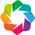

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
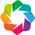

In [57]:
import cartopy.crs as ccrs

import geoviews as gv
import holoviews as hv
import numpy as np

from holoviews import opts
from holoviews.element.tiles import OSM

hv.extension('bokeh','matplotlib')
gv.extension("bokeh","matplotlib")

In [29]:
help(hv.Element.redim)

Help on property:




In [17]:
data_set_raw

<xarray.Dataset>
Dimensions:  (t: 25, x: 256, y: 256)
Coordinates:
  * t        (t) datetime64[ns] 2021-01-02 2021-01-05 ... 2021-03-28 2021-03-31
  * x        (x) float64 2.488e+05 2.488e+05 2.488e+05 ... 2.513e+05 2.513e+05
  * y        (y) float64 4.304e+06 4.304e+06 4.304e+06 ... 4.302e+06 4.302e+06
Data variables:
    crs      |S1 ...
    swir1    (t, y, x) float32 ...
    nir      (t, y, x) float32 ...
    green    (t, y, x) float32 ...
Attributes:
    Conventions:  CF-1.8
    institution:  openEO platform

In [47]:
kdims = ["x", "y", "t"]
vdims = ["swir1", "nir", "green"]

hv.Dimension.type_formatters[np.datetime64] = '%Y-%m-%d'  # readable time format
gv_raw = gv.Dataset(data_set_raw, kdims=kdims, vdims=vdims, crs=ccrs.UTM(31)).redim(x="lon", y="lat")

print(repr(gv_raw))

:Dataset   [lon,lat,t]   (swir1,nir,green)


In [69]:
holomap = gv_raw.to(gv.Image, ["lon", "lat"], "green").opts(cmap="turbo")
holomap

:HoloMap   [t]
   :Image   [lon,lat]   (green)

# Smoothen images
Smoothen base images

In [38]:
smoothed_dc = combined_dc.resample_cube_spatial(method="cubic", target=combined_dc)  # TODO: find scale on which we want to do the processing

In [ ]:
smoothed_dc_filename = out_dir / "smoothed.nc"
smoothed_dc.download(smoothed_dc_filename, format="netcdf")

In [ ]:
data_set_raw: xr.Dataset = xr.open_dataset(smoothed_dc_filename)
data_set_raw["green"].hvplot(
    groupby="t",
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

## Divide the data into time-bands
Data is divided in bands of a variable amount of years. Sort the data and take n-th percentile of every time-band.

In [39]:
from pathlib import Path
from datetime import timedelta
import pandas as pd

year_interval: int = 1
percentile: float = 0.2  # fractions [0 - 1]
bucketed_netcdf_filename: str = "bucketed.nc"

if debug:
    dr: pd.DatetimeIndex = pd.date_range(start=temporal_extent[0], end=temporal_extent[1], freq="MS")
else:
    dr: pd.DatetimeIndex = pd.date_range(start=temporal_extent[0], end=temporal_extent[1], freq=f"{year_interval}YS")

In [40]:
from openeo import processes

if debug:
    image_count_limit: int = 5  # Will exclude some images
else:
    image_count_limit: int = 10

t_intervals = [[str(d), str(dr[i+1])] for i, d in enumerate(dr[:-1])]

# Create bucketed DC based on percentile of images
t_bucketed_dc: DataCube = smoothed_dc \
    .aggregate_temporal(
        intervals=t_intervals,
        reducer=lambda data: processes.quantiles(data, probabilities=[percentile]),
        labels=[t_int[0] for t_int in t_intervals]
    )

# # Create bucketed DC based on image count
# # Workaround for now is to set images to 1 until count works
# count_dc: DataCube = smoothed_dc.band("green") \
#     .multiply(0).add(1) \
#     .aggregate_temporal(
#         intervals=t_intervals,
#         reducer=lambda data: sum(data),
#         labels=[t_int[0] for t_int in t_intervals]
#     )
# count_mask: DataCube = count_dc.apply(lambda val: lt(x=val, y=image_count_limit))

# # Mask for areas with too few images
# t_bucketed_dc = t_bucketed_dc.mask(mask=count_mask, replacement=0)
print(len(t_intervals))

3


In [ ]:
# Download count dc
count_dc.download(out_dir / "count.nc", format="netcdf")

In [ ]:
# download bucketed dc
t_bucketed_dc.download(out_dir / "bucket.nc", format="netcdf")

In [ ]:
t_bucketed_ds: xr.Dataset = xr.open_dataset(out_dir / "bucket.nc")
t_bucketed_ds
t_bucketed_ds["green"].hvplot(
    groupby="t",
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

In [ ]:
files = get_files_from_dc(t_bucketed_dc, out_dir / "bucketed", 't_bucketing_aquamonitor')

In [ ]:
data_set_bucketed: xr.Dataset = xr.open_dataset(out_dir / "bucketed" / "openEO.nc")

In [ ]:
data_set_bucketed

data_set_bucketed["green"].hvplot(
    groupby="t",
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

## Create the time-bucketed NDWI cube
To detect surface-to-water changes and vice-versa, we rely on the NDWI: $$NDWI = \frac{\rho_{green} - \rho_{nir}}{\rho_{green} + \rho_{nir}}$$
and on the MNDWI: $$MNDWI = \frac{\rho_{green} - \rho_{swir}}{\rho_{green} + \rho_{swir}}$$

In [41]:
# Create products
from typing import Tuple

green: DataCube = t_bucketed_dc.band("green")
nir: DataCube = t_bucketed_dc.band("nir")
swir: DataCube = t_bucketed_dc.band("swir")
ndwi: DataCube = (green - nir) / (green + nir)
mndwi: DataCube = (green - swir) / (green + swir)

# Rescale
def rescale(dc: DataCube, factors: Tuple[float]) -> DataCube:
    return dc.subtract(factors[0]).divide(factors[1] - factors[0])

rescaled_mndwi = rescale(mndwi, factors=(-0.6, 0.6))

In [ ]:
# Also download dataset for local testing with linear regression
mndwi.download(out_dir / "mndwi.nc", format="NetCDF")
# mndwi.download(out_dir / "mndwi.json", format="json")

In [ ]:
files = get_files_from_dc(rescaled_mndwi, out_dir / "mndwi", 'mndwi_calculation')

In [ ]:
data_set_mndwi: xr.Dataset = xr.open_dataset(out_dir / "mndwi2.nc")
# data_set_mndwi: xr.Dataset = xr.open_dataset(out_dir / "mndwi" / "openEO.nc")
data_set_mndwi
data_set_mndwi["var"].hvplot(
    groupby="t",
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

## Perform a linear regression on each band
Compute the linear regression for the ndwi we use as our wetness indicator. The slope of the linear regression will be the indicator water-to-surface changes or vice-versa.

In [42]:
def load_udf(udf_path: Union[str, Path]):
    with open(udf_path, "r+") as f:
        return f.read()

linear_regression_udf_path: Path = Path(Path.cwd().parent / "udfs" / "linear_regression.py")
linear_regression_udf: str = load_udf(linear_regression_udf_path)

For debugging purposes, we can run the udf locally

In [ ]:
# Tryout the UDF locally
from openeo.udf import execute_local_udf, UdfData

# out_dir_udf = out_dir / "out"
# out_dir_udf.mkdir(parents=True, exist_ok=True)
ds = xr.open_dataset(out_dir / "mndwi.nc", engine='netcdf4')

r = ds["var"]
# build dimension list in proper order
dims = list(filter(lambda i: i != 't' and i != 'bands' and i != 'x' and i != 'y', r.dims))
if 't' in r.dims: dims += ['t']
if 'bands' in r.dims: dims += ['bands']
if 'x' in r.dims: dims += ['x']
if 'y' in r.dims: dims += ['y']
# return the resulting data array
local_da: xr.DataArray = r.transpose(*dims)
udf_res: UdfData = execute_local_udf(linear_regression_udf, local_da)
udf_res.get_datacube_list()[0].get_array().hvplot(
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

In [43]:
lin_reg: DataCube = rescaled_mndwi.reduce_temporal_udf(code=linear_regression_udf, runtime="Python")

## Masking
Masks are created for areas that:
- have too few images
- have no clear changes from land-to-water or vice versa

In [44]:
from openeo import processes
from dateutil.parser import parse
ndwi_min_water: float = -0.05 # minimum value of NDWI to assume as water
ndwi_max_land: float = 0.5
slope_threshold: float = 0.025
start: datetime = parse(temporal_extent[0])
stop: datetime = parse(temporal_extent[1])

if debug:
    min_num_images: int = 5
else:
    min_num_images: int = 20

# 15 / (stop_year - start_year)
slope_threshold_ratio: float = 15 * 365.25 / float(stop.__sub__(start).days)

mndwi_min: DataCube = rescaled_mndwi.reduce_dimension(dimension="t", reducer="min")
mndwi_max: DataCube = rescaled_mndwi.reduce_dimension(dimension="t", reducer="max")
min_water_mask: DataCube = mndwi_min.apply(lambda val: processes.gt(x=val, y=ndwi_min_water))
max_land_mask: DataCube = mndwi_max.apply(lambda val: processes.lt(x=val, y=ndwi_max_land))

# Create bucketed DC based on image count
# Workaround for now is to set images to 1 until count works
num_images_mask: DataCube = smoothed_dc.band("green") \
    .apply(lambda data: processes.add(x=processes.multiply(x=data, y=0), y=1)) \
    .aggregate_temporal(
        intervals=t_intervals,
        reducer=lambda data: processes.sum(data),
        labels=[t_int[0] for t_int in t_intervals]
    ) \
    .apply(lambda val: processes.gt(x=val, y=image_count_limit-1)) \
    .reduce_dimension(
        dimension="t",
        reducer=lambda data: processes.product(data)
    ) \
    .apply(lambda data: processes.eq(x=data, y=0))
# num_images_mask = num_images_mask.add_dimension(label=f"{start.year}_{stop.year}", name="t", type="temporal")  # Adding a mask without t is not supported


mask: DataCube = lin_reg.apply(processes.absolute).apply(lambda val: processes.gt(x=val, y=slope_threshold * slope_threshold_ratio)) \
    .multiply(min_water_mask) \
    .multiply(max_land_mask) \
    .multiply(num_images_mask)
# lin_reg = lin_reg.add_dimension(label=f"{start.year}_{stop.year}", name="t", type="temporal")  # Adding a mask without t is not supported

lin_reg = lin_reg.mask(mask)
# lin_reg = lin_reg * mask

In [45]:
lin_reg.download(out_dir / "lin_reg.nc", format="netcdf")
# mask.download(out_dir / "mask.nc", format="netcdf")

In [ ]:
files = get_files_from_dc(lin_reg, out_dir / "lin_reg", 'linear_regression aquamonitor')

In [46]:
data_set_lin_reg: xr.Dataset = xr.open_dataset(out_dir / "lin_reg.nc") # " / "openEO.nc")
data_set_lin_reg
data_set_lin_reg["var"].hvplot(
    cmap="turbo",
    widget_type="scrubber",
    widget_location="bottom"
)

HoloViews(Image, widget_location='bottom', widget_type='scrubber')